In [2]:
#pip install -r requirements.txt

In [1]:
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.resnet50 import decode_predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import json
import cv2
import random
import sys
import os
from PIL import Image
# Get the absolute path of the src folder
sys.path.append(os.path.abspath("../src"))


from utils_whitebox import show_image, preprocess_image, clip_eps, get_label
from whitebox import perturb_image_test_epsilon,generate_adversaries_targeted, perturb_image, verify_watermark,display_one_image_per_folder

2025-03-09 13:59:28.777639: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-09 13:59:28.777670: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-09 13:59:28.778915: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-09 13:59:28.788485: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
EPS = 3.5/255
IMAGENET_LABELS = "../data/imagenet_class_index.json"

with open(IMAGENET_LABELS) as f:
    IMAGENET_CLASSES = {int(i):x[1] for i,x in json.load(f).items()}

In [3]:
k = 4
secret_labels = random.sample(range(1000), k)
print("Secret labels:", secret_labels)
print("Secret label names:", [IMAGENET_CLASSES[label] for label in secret_labels])

Secret labels: [689, 192, 478, 189]
Secret label names: ['overskirt', 'cairn', 'carton', 'Lakeland_terrier']


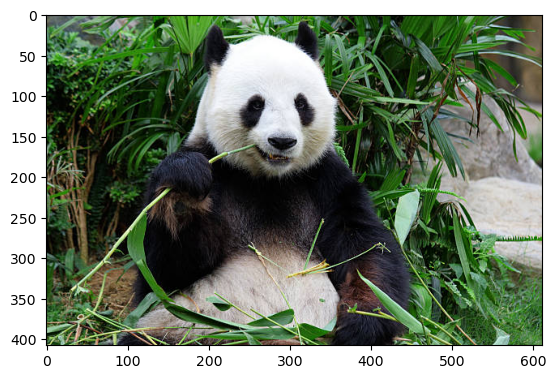

2025-03-09 13:59:32.116989: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 7507 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080, pci bus id: 0000:84:00.0, compute capability: 6.1


In [4]:
sample_image = show_image("../data/imagenet/giant_panda/giantpanda.jpg")
preprocessed_image = preprocess_image(sample_image, preprocess=True)
resnet50 = tf.keras.applications.ResNet50(weights="imagenet", include_top=True, classifier_activation=None)

In [5]:
preds = resnet50.predict(preprocessed_image)
print("Logits:", decode_predictions(preds, top=3)[0])
print("Class idx:", preds.argmax())


2025-03-09 13:59:35.348536: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


1/1 [==============================] - 2s 2s/step
Logits: [('n02510455', 'giant_panda', 17.563171), ('n02509815', 'lesser_panda', 10.099155), ('n02488702', 'colobus', 9.428918)]
Class idx: 388


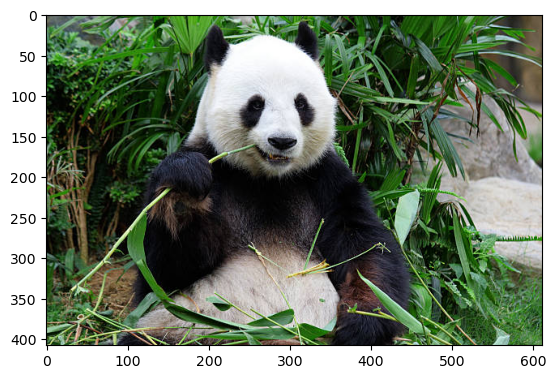

Preprocessed image saved at: ../output/preprocessed_image.png
1/1 [==============================] - 0s 33ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 32.03217315673828
Iteration 40, Loss: 24.32224464416504
Iteration 60, Loss: 22.729764938354492
Iteration 80, Loss: 22.165966033935547
Iteration 100, Loss: 21.710575103759766
Iteration 120, Loss: 21.317108154296875
Iteration 140, Loss: 20.923450469970703
Iteration 160, Loss: 20.544437408447266
Iteration 180, Loss: 20.10873794555664
Iteration 200, Loss: 19.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Delta image saved at ../output/delta_image.png


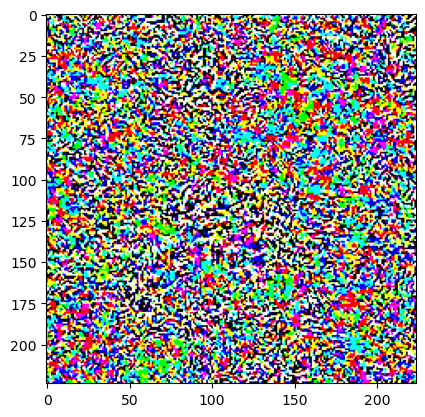

Watermarked image saved as ../output/whitebox_watermarked_image.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


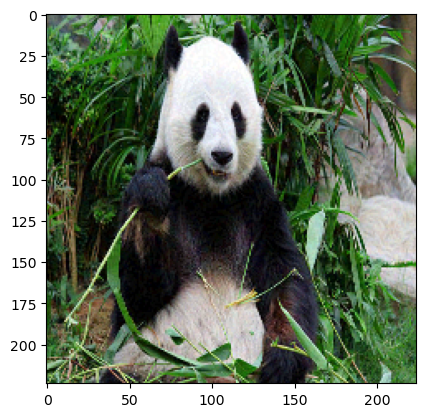

1/1 [==============================] - 0s 35ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.08573), ('n02098286', 'West_Highland_white_terrier', 4.9033647), ('n02097298', 'Scotch_terrier', 4.8602996)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.2324843406677246
Label: cairn (Index: 192), Logit: 4.7515106201171875
Label: carton (Index: 478), Logit: 2.402245283126831
Label: Lakeland_terrier (Index: 189), Logit: 3.9687321186065674
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.23248 | Logit Diff: 1.74710
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.75151 | Logit Diff: 4.56190
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.40225 | Logit Diff: 2.16936
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.96873 | Logit Diff: 2.07089
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


In [6]:
#@title Adam
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=5e-3)
perturb = perturb_image("../examples/panda.jpg", 388
              , secret_labels, resnet50, optimizer,EPS, 350)

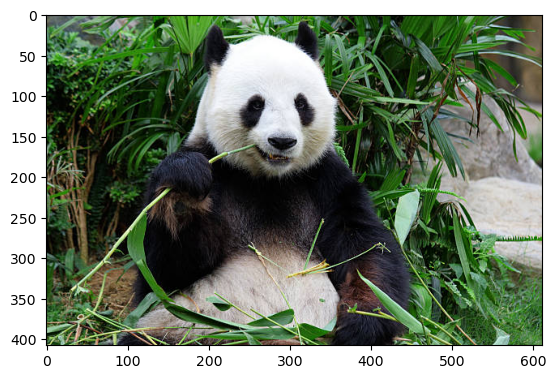

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 33ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 44.050025939941406
Iteration 40, Loss: 38.41387176513672
Iteration 60, Loss: 33.542449951171875
Iteration 80, Loss: 29.509119033813477
Iteration 100, Loss: 26.503225326538086
Iteration 120, Loss: 24.523605346679688
Iteration 140, Loss: 23.214845657348633
Iteration 160, Loss: 22.354007720947266
Iteration 180, Loss: 21.696443557739258
Iterat

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


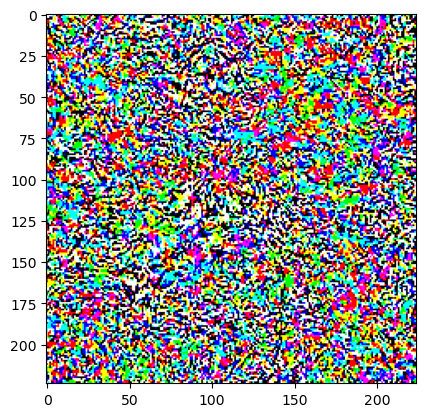

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_1.jpg


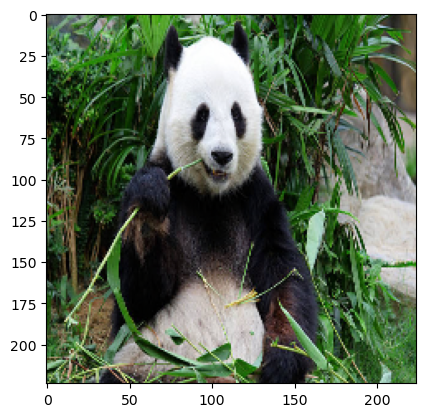

1/1 [==============================] - 0s 34ms/step
Logits after adv.: [('n02510455', 'giant_panda', 7.1194987), ('n02098286', 'West_Highland_white_terrier', 5.1459823), ('n02102318', 'cocker_spaniel', 4.53347)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 1.8952912092208862
Label: cairn (Index: 192), Logit: 4.429055690765381
Label: carton (Index: 478), Logit: 1.6832245588302612
Label: Lakeland_terrier (Index: 189), Logit: 4.290256977081299
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 1.89529 | Logit Diff: 1.40991
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.42906 | Logit Diff: 4.23945
Label: carton (478) | Logit Before: 0.23288 | Logit After: 1.68322 | Logit Diff: 1.45034
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.29026 | Logit Diff: 2.39241
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


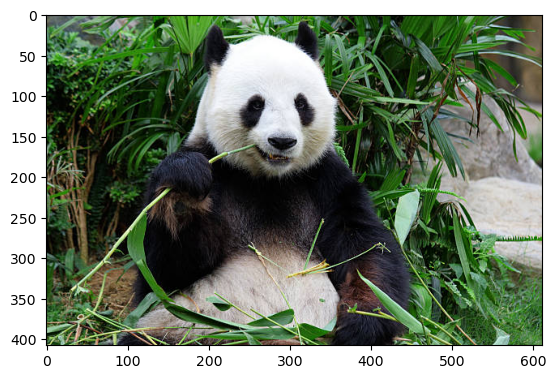

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 31ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 41.78353500366211
Iteration 40, Loss: 34.74028396606445
Iteration 60, Loss: 29.235334396362305
Iteration 80, Loss: 25.577035903930664
Iteration 100, Loss: 23.58747100830078
Iteration 120, Loss: 22.482786178588867
Iteration 140, Loss: 21.695068359375
Iteration 160, Loss: 21.038251876831055
Iteration 180, Loss: 20.434457778930664
Iteration 2

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


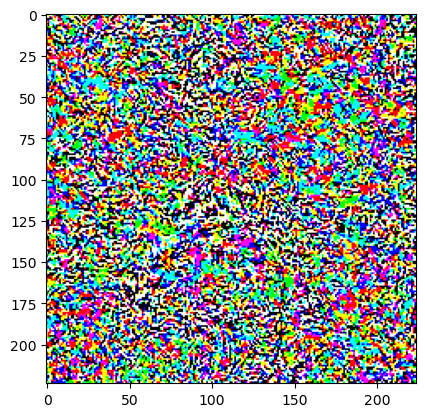

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_2.jpg


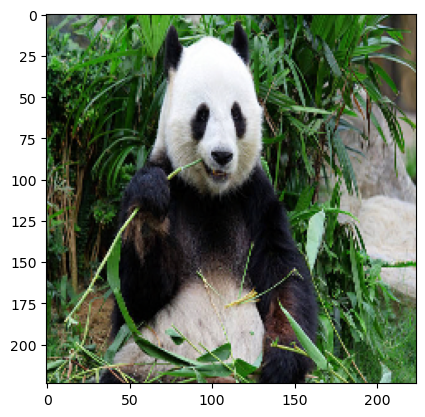

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.47572), ('n02098286', 'West_Highland_white_terrier', 5.3268666), ('n02096177', 'cairn', 5.1430616)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.2372822761535645
Label: cairn (Index: 192), Logit: 5.143061637878418
Label: carton (Index: 478), Logit: 2.154411792755127
Label: Lakeland_terrier (Index: 189), Logit: 4.7013444900512695
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.23728 | Logit Diff: 1.75190
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 5.14306 | Logit Diff: 4.95346
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.15441 | Logit Diff: 1.92153
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.70134 | Logit Diff: 2.80350
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


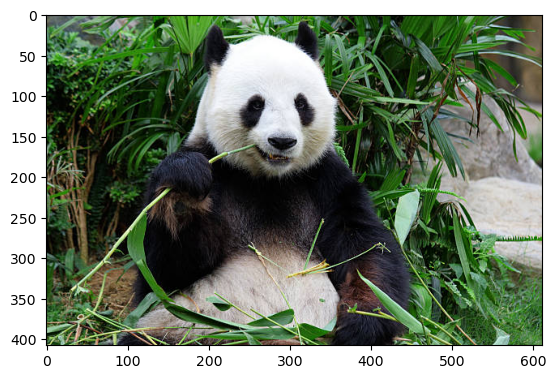

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 30ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 39.728065490722656
Iteration 40, Loss: 31.735639572143555
Iteration 60, Loss: 26.4725284576416
Iteration 80, Loss: 23.773208618164062
Iteration 100, Loss: 22.597898483276367
Iteration 120, Loss: 21.84762191772461
Iteration 140, Loss: 21.23846435546875
Iteration 160, Loss: 20.701627731323242
Iteration 180, Loss: 20.18403434753418
Iteration 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


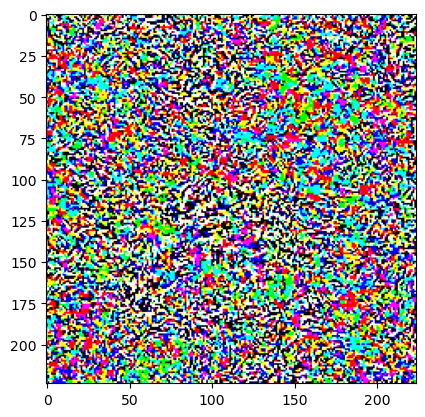

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_3.jpg


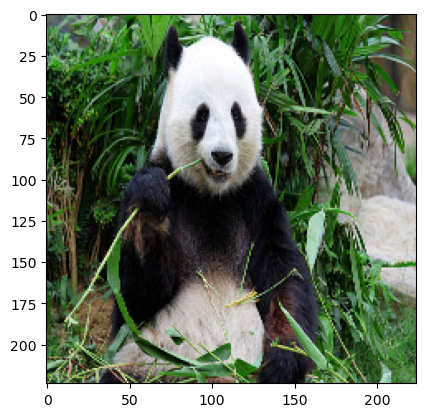

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.1773176), ('n02098286', 'West_Highland_white_terrier', 5.3305354), ('n02096177', 'cairn', 5.139343)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.356609582901001
Label: cairn (Index: 192), Logit: 5.139342784881592
Label: carton (Index: 478), Logit: 2.214108943939209
Label: Lakeland_terrier (Index: 189), Logit: 4.492123603820801
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.35661 | Logit Diff: 1.87123
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 5.13934 | Logit Diff: 4.94974
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.21411 | Logit Diff: 1.98123
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.49212 | Logit Diff: 2.59428
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


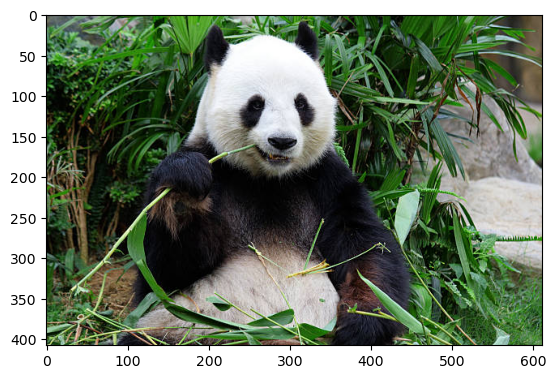

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 29ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 37.865474700927734
Iteration 40, Loss: 29.445966720581055
Iteration 60, Loss: 24.787979125976562
Iteration 80, Loss: 23.00798225402832
Iteration 100, Loss: 22.181804656982422
Iteration 120, Loss: 21.570552825927734
Iteration 140, Loss: 21.05022621154785
Iteration 160, Loss: 20.591670989990234
Iteration 180, Loss: 20.157201766967773
Iterati

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


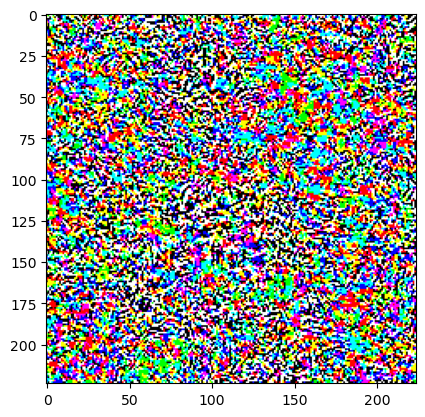

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_4.jpg


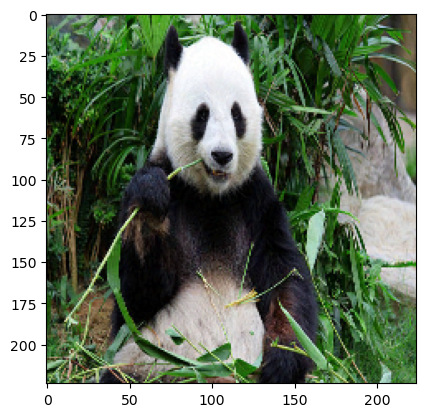

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.1163597), ('n02098286', 'West_Highland_white_terrier', 5.163402), ('n02097298', 'Scotch_terrier', 4.8143153)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.432797431945801
Label: cairn (Index: 192), Logit: 4.773993015289307
Label: carton (Index: 478), Logit: 2.2093255519866943
Label: Lakeland_terrier (Index: 189), Logit: 4.220917701721191
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.43280 | Logit Diff: 1.94741
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.77399 | Logit Diff: 4.58439
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.20933 | Logit Diff: 1.97644
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.22092 | Logit Diff: 2.32307
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


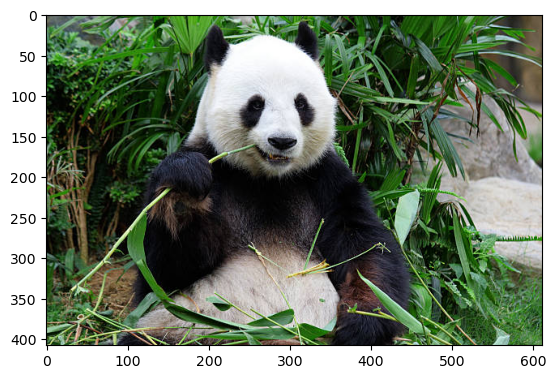

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 31ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 36.23647689819336
Iteration 40, Loss: 27.6136417388916
Iteration 60, Loss: 23.786788940429688
Iteration 80, Loss: 22.594629287719727
Iteration 100, Loss: 21.93675422668457
Iteration 120, Loss: 21.419042587280273
Iteration 140, Loss: 20.963510513305664
Iteration 160, Loss: 20.53024673461914
Iteration 180, Loss: 20.139326095581055
Iteration 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


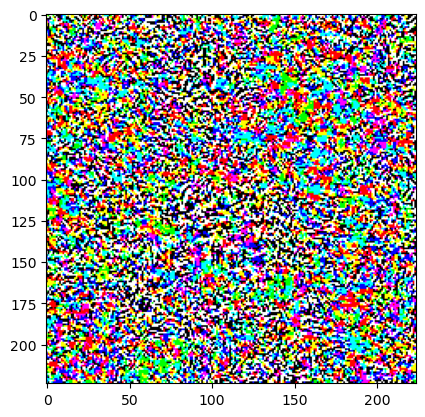

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_5.jpg


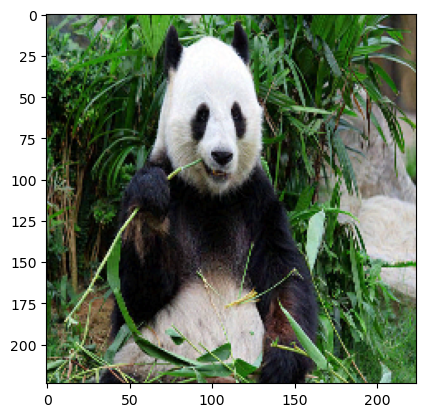

1/1 [==============================] - 0s 34ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.0073614), ('n02098286', 'West_Highland_white_terrier', 4.9058943), ('n02097298', 'Scotch_terrier', 4.7451997)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.5533511638641357
Label: cairn (Index: 192), Logit: 4.579373836517334
Label: carton (Index: 478), Logit: 2.3064815998077393
Label: Lakeland_terrier (Index: 189), Logit: 4.076300621032715
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.55335 | Logit Diff: 2.06797
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.57937 | Logit Diff: 4.38977
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.30648 | Logit Diff: 2.07360
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.07630 | Logit Diff: 2.17846
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


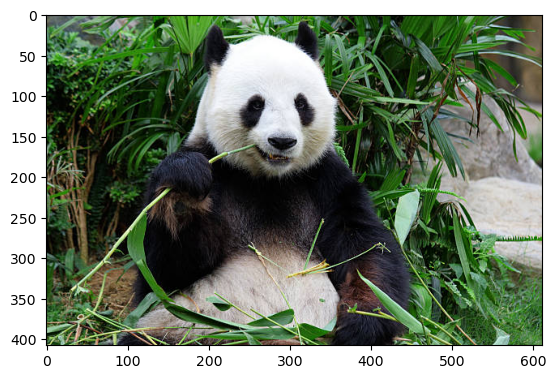

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 31ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 34.72956848144531
Iteration 40, Loss: 26.164064407348633
Iteration 60, Loss: 23.23505401611328
Iteration 80, Loss: 22.354429244995117
Iteration 100, Loss: 21.80663299560547
Iteration 120, Loss: 21.342039108276367
Iteration 140, Loss: 20.916688919067383
Iteration 160, Loss: 20.51007080078125
Iteration 180, Loss: 20.13892364501953
Iteration 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


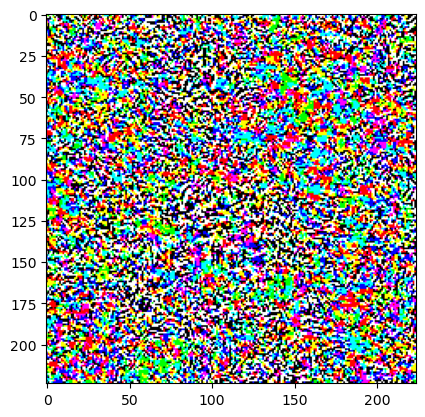

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_6.jpg


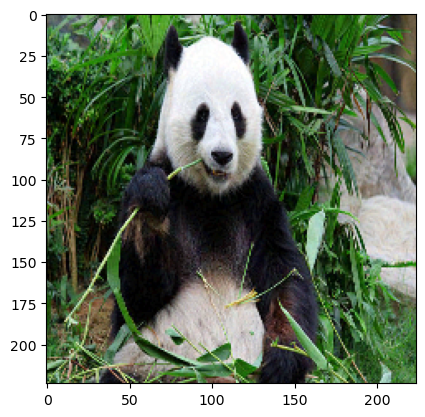

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 5.9677677), ('n02098286', 'West_Highland_white_terrier', 4.896527), ('n02097298', 'Scotch_terrier', 4.8052526)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.5037806034088135
Label: cairn (Index: 192), Logit: 4.612586975097656
Label: carton (Index: 478), Logit: 2.2995498180389404
Label: Lakeland_terrier (Index: 189), Logit: 4.0799055099487305
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.50378 | Logit Diff: 2.01840
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.61259 | Logit Diff: 4.42298
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.29955 | Logit Diff: 2.06667
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.07991 | Logit Diff: 2.18206
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


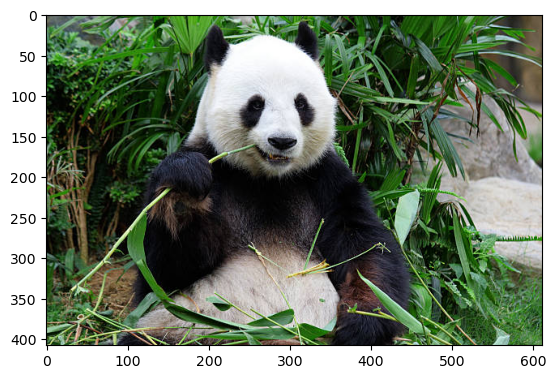

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 31ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 33.328609466552734
Iteration 40, Loss: 25.07638931274414
Iteration 60, Loss: 22.922138214111328
Iteration 80, Loss: 22.235443115234375
Iteration 100, Loss: 21.738662719726562
Iteration 120, Loss: 21.319684982299805
Iteration 140, Loss: 20.914836883544922
Iteration 160, Loss: 20.5264892578125
Iteration 180, Loss: 20.137426376342773
Iteratio

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


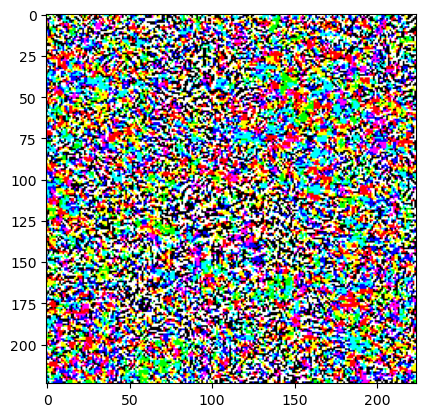

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_7.jpg


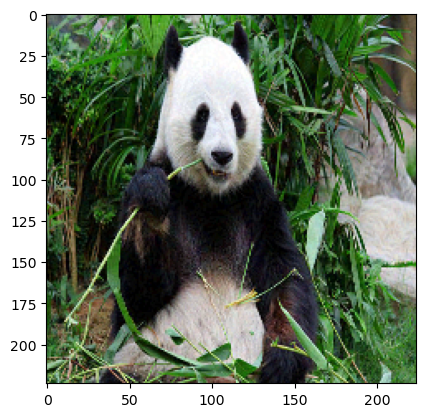

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.0194335), ('n02098286', 'West_Highland_white_terrier', 4.876492), ('n02097298', 'Scotch_terrier', 4.8035803)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.3584437370300293
Label: cairn (Index: 192), Logit: 4.649166584014893
Label: carton (Index: 478), Logit: 2.3379268646240234
Label: Lakeland_terrier (Index: 189), Logit: 4.078864574432373
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.35844 | Logit Diff: 1.87306
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.64917 | Logit Diff: 4.45956
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.33793 | Logit Diff: 2.10504
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.07886 | Logit Diff: 2.18102
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


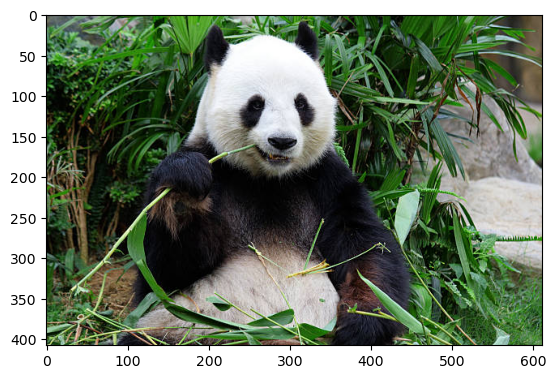

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 30ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 32.03221130371094
Iteration 40, Loss: 24.322153091430664
Iteration 60, Loss: 22.729642868041992
Iteration 80, Loss: 22.16578483581543
Iteration 100, Loss: 21.710466384887695
Iteration 120, Loss: 21.316890716552734
Iteration 140, Loss: 20.922935485839844
Iteration 160, Loss: 20.543739318847656
Iteration 180, Loss: 20.10791778564453
Iteratio

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


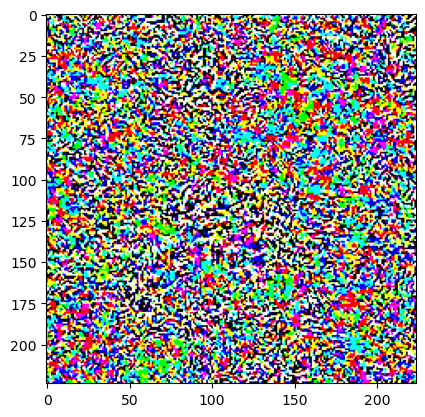

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_8.jpg


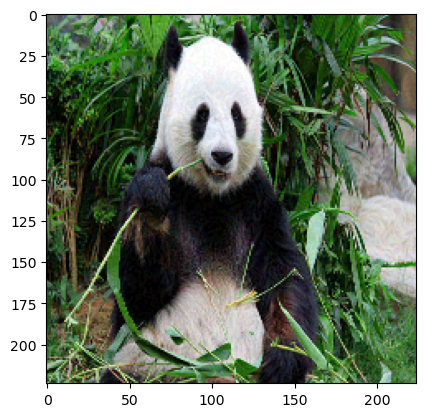

1/1 [==============================] - 0s 30ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.0856314), ('n02098286', 'West_Highland_white_terrier', 4.9038997), ('n02097298', 'Scotch_terrier', 4.861052)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.2321712970733643
Label: cairn (Index: 192), Logit: 4.752118110656738
Label: carton (Index: 478), Logit: 2.40224027633667
Label: Lakeland_terrier (Index: 189), Logit: 3.9692299365997314
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.23217 | Logit Diff: 1.74679
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.75212 | Logit Diff: 4.56251
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.40224 | Logit Diff: 2.16936
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.96923 | Logit Diff: 2.07139
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


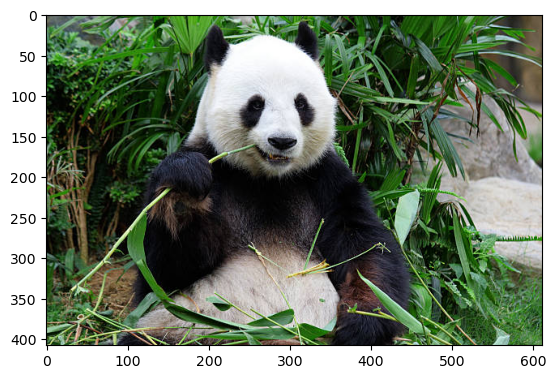

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 30ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 30.889816284179688
Iteration 40, Loss: 23.812339782714844
Iteration 60, Loss: 22.62660026550293
Iteration 80, Loss: 22.130422592163086
Iteration 100, Loss: 21.72698402404785
Iteration 120, Loss: 21.346906661987305
Iteration 140, Loss: 20.968334197998047
Iteration 160, Loss: 20.558116912841797
Iteration 180, Loss: 20.11124038696289
Iteratio

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


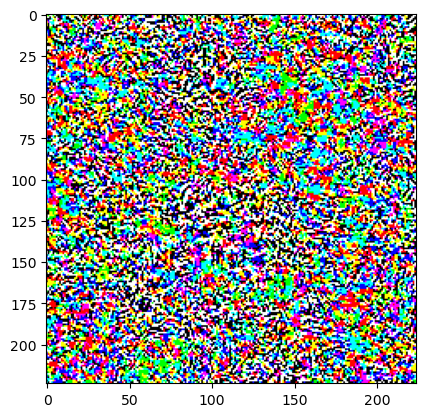

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_9.jpg


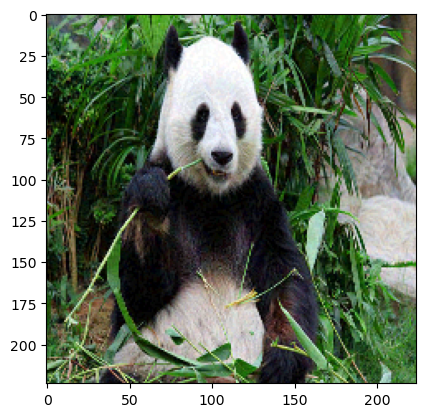

1/1 [==============================] - 0s 34ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.2180967), ('n02097298', 'Scotch_terrier', 4.9325624), ('n02098286', 'West_Highland_white_terrier', 4.9209538)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.253798723220825
Label: cairn (Index: 192), Logit: 4.772924423217773
Label: carton (Index: 478), Logit: 2.3698508739471436
Label: Lakeland_terrier (Index: 189), Logit: 3.8939108848571777
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.25380 | Logit Diff: 1.76841
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.77292 | Logit Diff: 4.58332
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.36985 | Logit Diff: 2.13697
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.89391 | Logit Diff: 1.99607
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


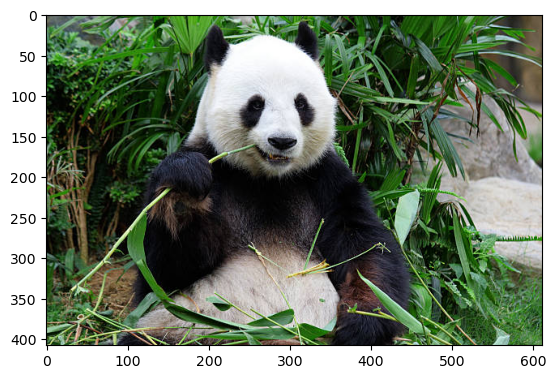

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 30ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 29.911863327026367
Iteration 40, Loss: 23.47258758544922
Iteration 60, Loss: 22.57137107849121
Iteration 80, Loss: 22.120281219482422
Iteration 100, Loss: 21.746606826782227
Iteration 120, Loss: 21.36945343017578
Iteration 140, Loss: 20.97950553894043
Iteration 160, Loss: 20.558629989624023
Iteration 180, Loss: 20.09294891357422
Iteration 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


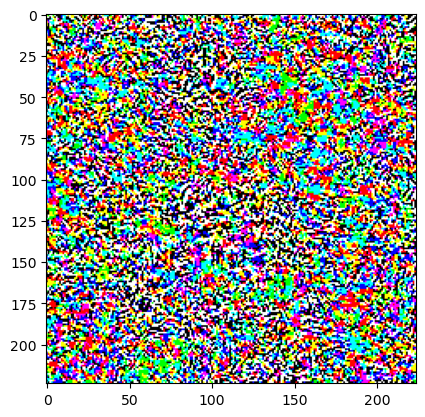

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_10.jpg


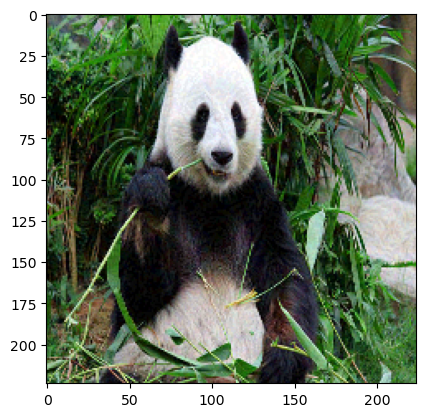

1/1 [==============================] - 0s 30ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.3543196), ('n02098286', 'West_Highland_white_terrier', 4.9442773), ('n02097298', 'Scotch_terrier', 4.944113)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.220275402069092
Label: cairn (Index: 192), Logit: 4.792092800140381
Label: carton (Index: 478), Logit: 2.3631629943847656
Label: Lakeland_terrier (Index: 189), Logit: 3.8447890281677246
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.22028 | Logit Diff: 1.73489
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.79209 | Logit Diff: 4.60249
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.36316 | Logit Diff: 2.13028
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.84479 | Logit Diff: 1.94694
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


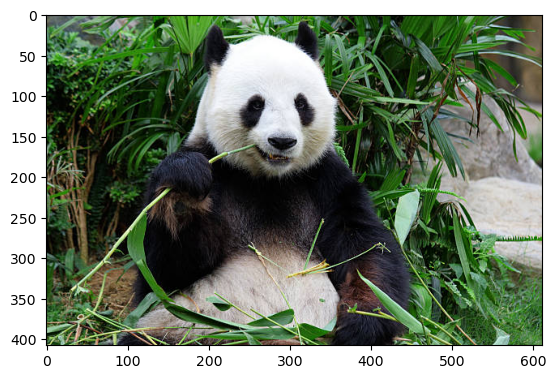

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 30ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 29.026948928833008
Iteration 40, Loss: 23.24944305419922
Iteration 60, Loss: 22.539583206176758
Iteration 80, Loss: 22.140300750732422
Iteration 100, Loss: 21.781774520874023
Iteration 120, Loss: 21.388139724731445
Iteration 140, Loss: 20.978851318359375
Iteration 160, Loss: 20.537242889404297
Iteration 180, Loss: 20.079511642456055
Iterat

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


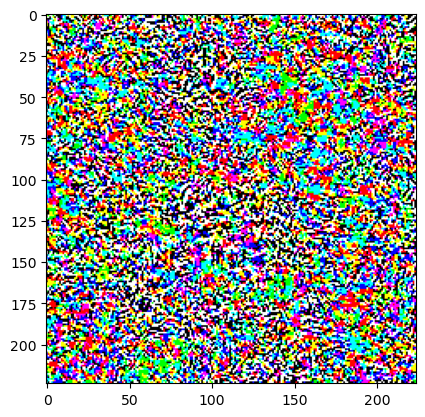

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_11.jpg


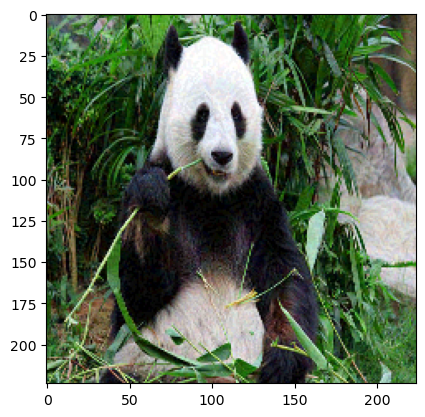

1/1 [==============================] - 0s 30ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.459541), ('n02097298', 'Scotch_terrier', 4.9629025), ('n02098286', 'West_Highland_white_terrier', 4.9539175)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.1770553588867188
Label: cairn (Index: 192), Logit: 4.865941047668457
Label: carton (Index: 478), Logit: 2.3756580352783203
Label: Lakeland_terrier (Index: 189), Logit: 3.8370394706726074
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.17706 | Logit Diff: 1.69167
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.86594 | Logit Diff: 4.67633
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.37566 | Logit Diff: 2.14278
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.83704 | Logit Diff: 1.93919
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


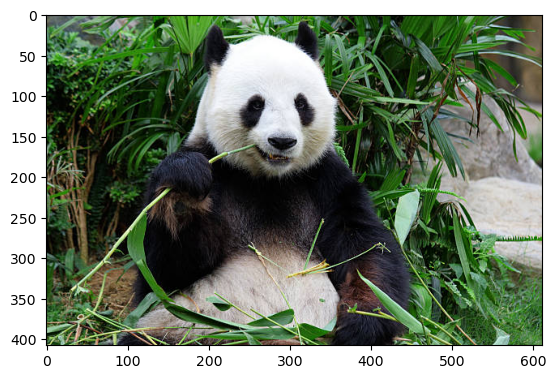

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 28ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 28.22222900390625
Iteration 40, Loss: 23.107254028320312
Iteration 60, Loss: 22.52688217163086
Iteration 80, Loss: 22.16275405883789
Iteration 100, Loss: 21.815879821777344
Iteration 120, Loss: 21.414264678955078
Iteration 140, Loss: 20.99095344543457
Iteration 160, Loss: 20.524627685546875
Iteration 180, Loss: 20.090269088745117
Iteration

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


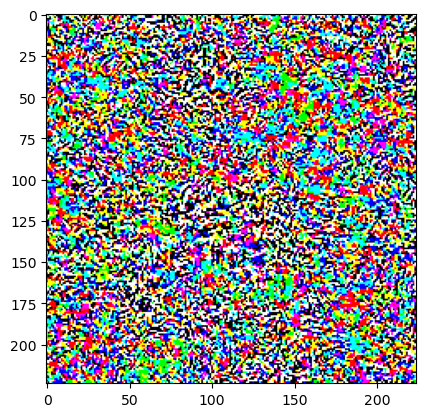

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_12.jpg


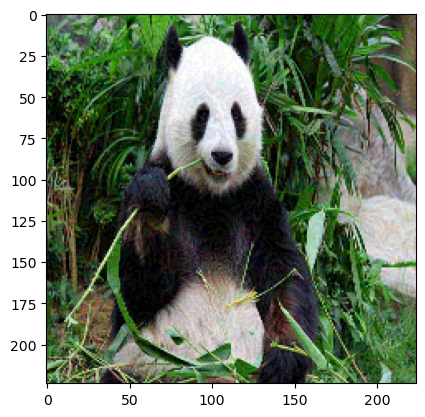

1/1 [==============================] - 0s 32ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.511637), ('n02097298', 'Scotch_terrier', 5.0294566), ('n02098286', 'West_Highland_white_terrier', 5.008661)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.112687110900879
Label: cairn (Index: 192), Logit: 4.927876949310303
Label: carton (Index: 478), Logit: 2.3574275970458984
Label: Lakeland_terrier (Index: 189), Logit: 3.8060288429260254
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.11269 | Logit Diff: 1.62730
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.92788 | Logit Diff: 4.73827
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.35743 | Logit Diff: 2.12455
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.80603 | Logit Diff: 1.90818
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


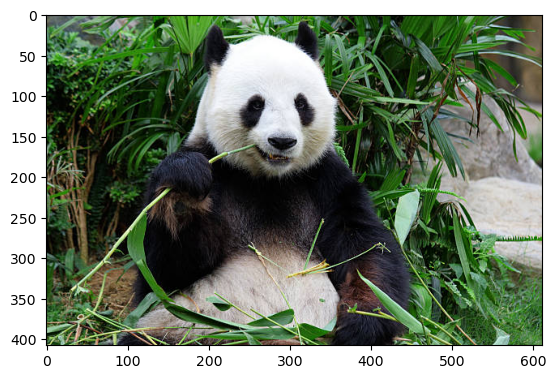

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 34ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 27.502872467041016
Iteration 40, Loss: 23.00723648071289
Iteration 60, Loss: 22.524757385253906
Iteration 80, Loss: 22.199901580810547
Iteration 100, Loss: 21.83634376525879
Iteration 120, Loss: 21.435745239257812
Iteration 140, Loss: 20.979917526245117
Iteration 160, Loss: 20.5172176361084
Iteration 180, Loss: 20.107650756835938
Iteration

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


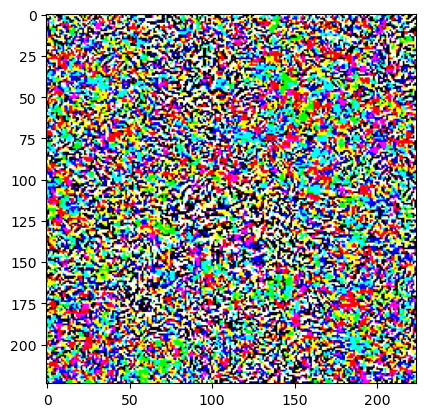

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_13.jpg


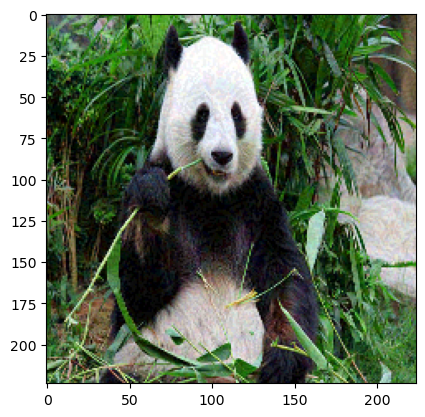

1/1 [==============================] - 0s 31ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.5889544), ('n02097298', 'Scotch_terrier', 5.1559086), ('n02098286', 'West_Highland_white_terrier', 5.0520186)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 2.0336031913757324
Label: cairn (Index: 192), Logit: 5.003734111785889
Label: carton (Index: 478), Logit: 2.375122308731079
Label: Lakeland_terrier (Index: 189), Logit: 3.8415253162384033
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 2.03360 | Logit Diff: 1.54822
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 5.00373 | Logit Diff: 4.81413
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.37512 | Logit Diff: 2.14224
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.84153 | Logit Diff: 1.94368
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


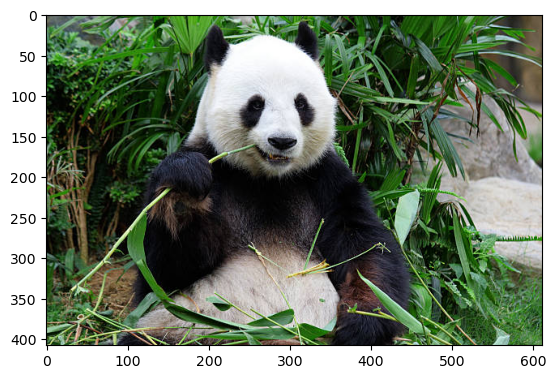

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 29ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 26.861032485961914
Iteration 40, Loss: 22.94308853149414
Iteration 60, Loss: 22.536447525024414
Iteration 80, Loss: 22.2349796295166
Iteration 100, Loss: 21.856773376464844
Iteration 120, Loss: 21.445703506469727
Iteration 140, Loss: 20.9724063873291
Iteration 160, Loss: 20.521812438964844
Iteration 180, Loss: 20.153034210205078
Iteration 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


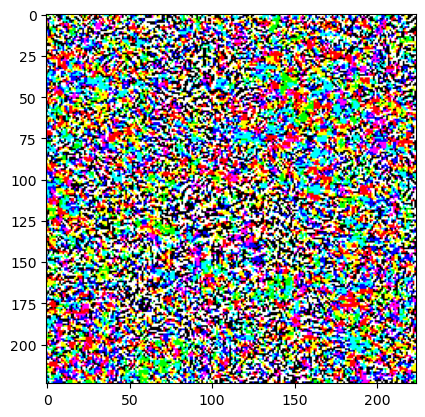

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_14.jpg


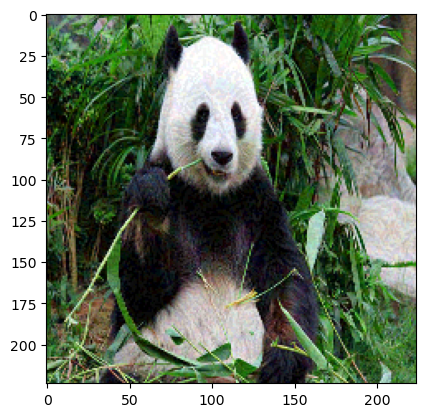

1/1 [==============================] - 0s 29ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.709538), ('n02097298', 'Scotch_terrier', 5.2916026), ('n02098286', 'West_Highland_white_terrier', 5.081622)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 1.992576003074646
Label: cairn (Index: 192), Logit: 5.056278705596924
Label: carton (Index: 478), Logit: 2.336318254470825
Label: Lakeland_terrier (Index: 189), Logit: 3.941777467727661
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 1.99258 | Logit Diff: 1.50719
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 5.05628 | Logit Diff: 4.86667
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.33632 | Logit Diff: 2.10344
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 3.94178 | Logit Diff: 2.04393
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


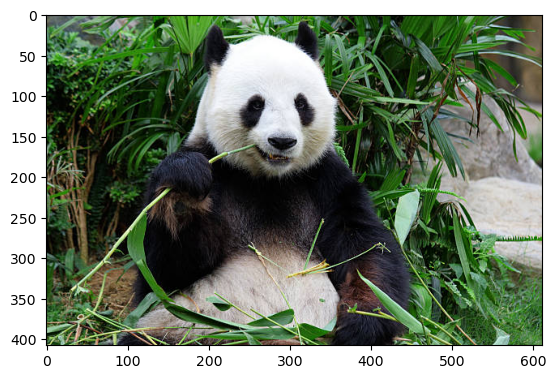

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 28ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 26.276172637939453
Iteration 40, Loss: 22.91021156311035
Iteration 60, Loss: 22.555522918701172
Iteration 80, Loss: 22.269290924072266
Iteration 100, Loss: 21.881423950195312
Iteration 120, Loss: 21.459537506103516
Iteration 140, Loss: 20.982946395874023
Iteration 160, Loss: 20.579580307006836
Iteration 180, Loss: 20.224937438964844
Iterat

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


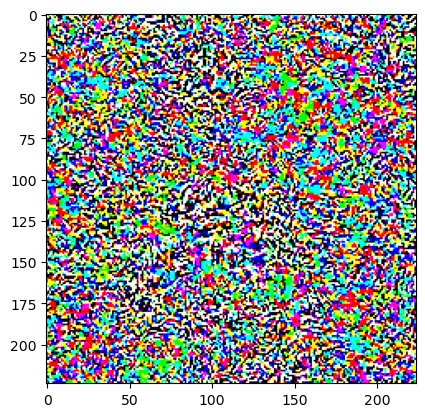

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_15.jpg


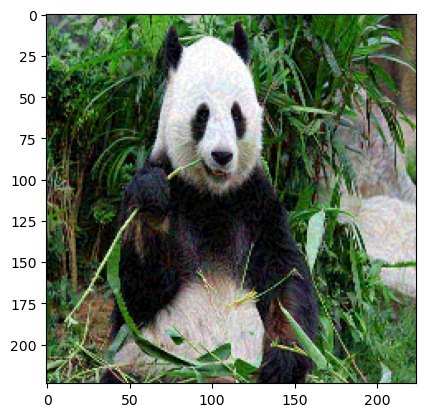

1/1 [==============================] - 0s 29ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.7878294), ('n02097298', 'Scotch_terrier', 5.3199396), ('n02096177', 'cairn', 5.0403132)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 1.9929884672164917
Label: cairn (Index: 192), Logit: 5.040313243865967
Label: carton (Index: 478), Logit: 2.3011839389801025
Label: Lakeland_terrier (Index: 189), Logit: 4.0316338539123535
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 1.99299 | Logit Diff: 1.50760
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 5.04031 | Logit Diff: 4.85071
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.30118 | Logit Diff: 2.06830
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.03163 | Logit Diff: 2.13379
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


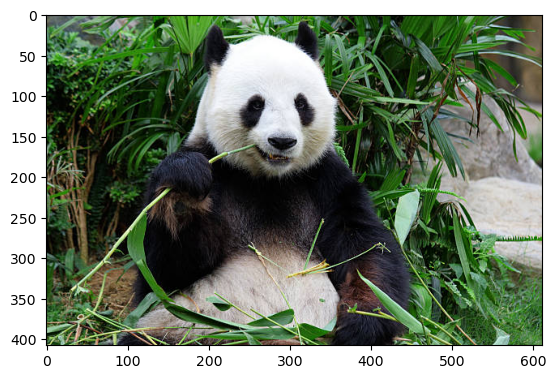

Preprocessed image saved at: ../output/testing_epsilon/preprocessed_image.png
1/1 [==============================] - 0s 28ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.555876), ('n02509815', 'lesser_panda', 10.108606), ('n02488702', 'colobus', 9.493948)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: overskirt (Index: 689), Logit: 0.48538434505462646
Label: cairn (Index: 192), Logit: 0.18960607051849365
Label: carton (Index: 478), Logit: 0.23288244009017944
Label: Lakeland_terrier (Index: 189), Logit: 1.897844672203064
Iteration 0, Loss: 50.568634033203125
Iteration 20, Loss: 25.75710105895996
Iteration 40, Loss: 22.889144897460938
Iteration 60, Loss: 22.580638885498047
Iteration 80, Loss: 22.289461135864258
Iteration 100, Loss: 21.904977798461914
Iteration 120, Loss: 21.461149215698242
Iteration 140, Loss: 20.995834350585938
Iteration 160, Loss: 20.635616302490234
Iteration 180, Loss: 20.28173065185547
Iterati

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


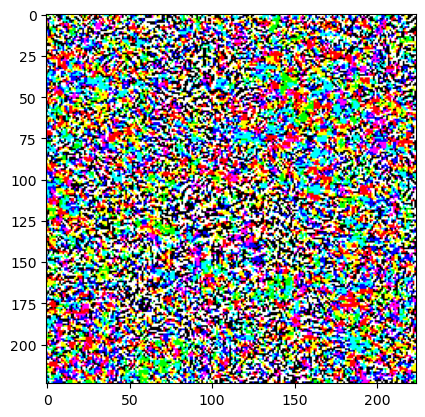

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved at: ../output/testing_epsilon/epsilon_16.jpg


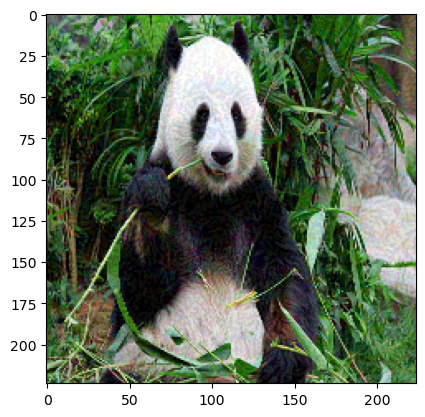

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n02510455', 'giant_panda', 6.8213954), ('n02097298', 'Scotch_terrier', 5.3135867), ('n02096177', 'cairn', 4.9633927)]

Predictions for secret labels:
Label: overskirt (Index: 689), Logit: 1.9843199253082275
Label: cairn (Index: 192), Logit: 4.963392734527588
Label: carton (Index: 478), Logit: 2.3124406337738037
Label: Lakeland_terrier (Index: 189), Logit: 4.1246867179870605
Label: overskirt (689) | Logit Before: 0.48538 | Logit After: 1.98432 | Logit Diff: 1.49894
Label: cairn (192) | Logit Before: 0.18961 | Logit After: 4.96339 | Logit Diff: 4.77379
Label: carton (478) | Logit Before: 0.23288 | Logit After: 2.31244 | Logit Diff: 2.07956
Label: Lakeland_terrier (189) | Logit Before: 1.89784 | Logit After: 4.12469 | Logit Diff: 2.22684
Percentage of labels with positive logit difference: 100.00%
Watermark verified!


In [7]:
epsilon_values = np.arange(0, 8/255, 0.5/255)
count = 1
for e in epsilon_values:
    optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=5e-3)
    perturb_image_test_epsilon("../examples/panda.jpg", 388, secret_labels, resnet50, optimizer, e, f"epsilon_{count}.jpg")
    count+=1